In [1]:
%tensorflow_version 2.x
import tensorflow as tf
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [2]:
!pip install mitdeeplearning
import mitdeeplearning as mdl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.3.0-py3-none-any.whl size=2117301 sha256=cb66728d9b75772d2d23796093e98647e63f74d2fbc7ddf83e45d5fec8c38ea3
  Stored in directory: /root/.cache/pip/wheels/9c/9f/b5/0e31f83bc60a83625e37429f923934e26802d0d68cf3ef3216
Successfully built mitdeeplearning


In [3]:
with open('jigs.txt') as f:
    string = f.read()
    jigs = string.split("\n\n\n")

with open('carrols.txt') as f:
    string = f.read()
    carrols = string.split("\n\n\n")

with open('hornpipes.txt') as f:
    string = f.read()
    hornpipes = string.split("\n\n\n")

with open('morris.txt') as f:
    string = f.read()
    morris = string.split("\n\n\n")

with open('playford.txt') as f:
    string = f.read()
    playford = string.split("\n\n\n")

with open('waltzes.txt') as f:
    string = f.read()
    waltzes = string.split("\n\n\n")

songs = []

for i in [jigs, carrols, hornpipes, morris, playford, waltzes]:
  for j in i:
    songs.append(j)

songs

['X: 1\nT:A and D\n% Nottingham Music Database\nS:EF\nM:4/4\nK:A\nM:6/8\nP:A\nf|"A"ecc c2f|"A"ecc c2f|"A"ecc c2f|"Bm"BcB "E7"B2f|\n"A"ecc c2f|"A"ecc c2c/2d/2|"D"efe "E7"dcB| [1"A"Ace a2:|\n [2"A"Ace ag=g||\\\nK:D\nP:B\n"D"f2f Fdd|"D"AFA f2e/2f/2|"G"g2g ecd|"Em"efd "A7"cBA|\n"D"f^ef dcd|"D"AFA f=ef|"G"gfg "A7"ABc |1"D"d3 d2e:|2"D"d3 d2||',
 '\nX: 2\nT:Abacus\n% Nottingham Music Database\nS:By Hugh Barwell, via Phil Rowe\nM:6/8\nK:G\n"G"g2g B^AB|d2d G3|"Em"GAB "Am"A2A|"D7"ABc "G"BAG|\n"G"g2g B^AB|d2d G2G|"Em"GAB "Am"A2G|"D7"FGA "G"G3::\n"D7"A^GA DFA|"G"B^AB G3|"A7"^c=c^c Ace|"D7"fef def|\n"G"g2g de=f|"E7"e2e Bcd|"Am"c2c "D7"Adc| [1"G"B2A G3:|\n [2"G"B2A G2F||"Em"E2E G2G|B2B e2e|"Am"c2A "B7"FBA|"Em"G2F E3|"Em"EFG "Am"ABc|\n"B7"B^c^d "Em"e2e|"F#7"f2f f2e|"B7"^def BAF|"Em"E2E G2G|B2B e2e|\n"Am"c2A "B7"FBA|"Em"G2F E3|"Em"EFG "Am"ABc|"B7"B^c^d "Em"e2e|\n"F#7"f2e "B7"^def |[1"Em"e3 "D7"d3:|[2"Em"e3 "E7"e3||',
 'X: 3\nT:The American Dwarf\n% Nottingham Music Database\nS:FTB, via EF\nM:6/8\nK:D\

In [4]:
songs_new = []

for i in range(4):
  for song in songs:
    if song[0] == '\n':
      songs_new.append(song[1:])
    else:
      songs_new.append(song)

songs_new

['X: 1\nT:A and D\n% Nottingham Music Database\nS:EF\nM:4/4\nK:A\nM:6/8\nP:A\nf|"A"ecc c2f|"A"ecc c2f|"A"ecc c2f|"Bm"BcB "E7"B2f|\n"A"ecc c2f|"A"ecc c2c/2d/2|"D"efe "E7"dcB| [1"A"Ace a2:|\n [2"A"Ace ag=g||\\\nK:D\nP:B\n"D"f2f Fdd|"D"AFA f2e/2f/2|"G"g2g ecd|"Em"efd "A7"cBA|\n"D"f^ef dcd|"D"AFA f=ef|"G"gfg "A7"ABc |1"D"d3 d2e:|2"D"d3 d2||',
 'X: 2\nT:Abacus\n% Nottingham Music Database\nS:By Hugh Barwell, via Phil Rowe\nM:6/8\nK:G\n"G"g2g B^AB|d2d G3|"Em"GAB "Am"A2A|"D7"ABc "G"BAG|\n"G"g2g B^AB|d2d G2G|"Em"GAB "Am"A2G|"D7"FGA "G"G3::\n"D7"A^GA DFA|"G"B^AB G3|"A7"^c=c^c Ace|"D7"fef def|\n"G"g2g de=f|"E7"e2e Bcd|"Am"c2c "D7"Adc| [1"G"B2A G3:|\n [2"G"B2A G2F||"Em"E2E G2G|B2B e2e|"Am"c2A "B7"FBA|"Em"G2F E3|"Em"EFG "Am"ABc|\n"B7"B^c^d "Em"e2e|"F#7"f2f f2e|"B7"^def BAF|"Em"E2E G2G|B2B e2e|\n"Am"c2A "B7"FBA|"Em"G2F E3|"Em"EFG "Am"ABc|"B7"B^c^d "Em"e2e|\n"F#7"f2e "B7"^def |[1"Em"e3 "D7"d3:|[2"Em"e3 "E7"e3||',
 'X: 3\nT:The American Dwarf\n% Nottingham Music Database\nS:FTB, via EF\nM:6/8\nK:D\nP

In [5]:
mdl.lab1.play_song(songs_new[-1])

In [6]:
# CONCATENATING ALL SONGS IN SONGS_NEW LIST TOGETHER
all_songs = "\n\n".join(songs_new)


# CREATING A VOCABULARY FOR SONGS BY FINDING ALL UNIQUE CHARACTERS
vocab = sorted(set(all_songs))

# CREATING INDEX FOR EACH UNIQUE CHARACTER
char_ind = {i:j for j, i in enumerate(vocab)}

# CREATING INVERSE OF CHAR_IDX TO CONVERT BACK THE INDICES TO CHARACTERS LATER
ind_char = np.array(vocab)

In [7]:
# WE NEED TO CONVERT THE TEXTUAL DATA INTO NUMERICAL DATA IN ORDER FOR IT'S CONVERSION

text_to_numerical_songs = np.array([char_ind[char] for char in all_songs])

In [8]:
text_to_numerical_songs.shape

(789774,)

In [9]:
# CREATING A FUNCTION TO GENERATE INPUT AND OUTPUT BATCH SEQUENCES

def generate_batches(songs, sequence_length, batch_size):

  l = songs.shape[0] - 1

  # RANDOMLY ALOTTING INDICES FOR GENERATING BATCHES
  indices = np.random.choice(l-sequence_length, batch_size)

  X = [songs[i : i+sequence_length] for i in indices]

  # SHIFTING THE INPUT SEQUENCES BY ONE CHARACTER TO THE RIGHT
  y = [songs[i+1 : i+sequence_length+1] for i in indices]

  X = np.reshape(X, [batch_size, sequence_length])
  y = np.reshape(y, [batch_size, sequence_length])

  return X, y

In [10]:
# SETTING UP HYPERPARAMETERS

vocab_size = len(vocab)
batch_size = 32
lstm_units = 1024
embedding_dim = 256
sequence_length = 128
learning_rate = 5e-3
num_training_iterations = 2000

In [11]:
# CREATING A LSTM MODEL USING TENSORFLOW SEQUENTIAL API

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    tf.keras.layers.LSTM(lstm_units, return_sequences=True, recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid', stateful=True),
    tf.keras.layers.Dense(vocab_size)
  ])

# PRINTING OUT THE SUMMARY OF THE MODEL
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           22528     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 88)            90200     
                                                                 
Total params: 5359704 (20.45 MB)
Trainable params: 5359704 (20.45 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [12]:
# CREATING TRAINING INPUT AND OUTPUT SEQUENCES

X, y = generate_batches(text_to_numerical_songs, sequence_length, batch_size)

In [13]:
# DEFINING LOSS FOR OUT LSTM MODEL

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)

  return loss

In [14]:
# CREATING A DIRECTORY FOR STORING THE MODEL WEIGHTS

checkpoint_directory = './trained_weights'
weights = os.path.join(checkpoint_directory, "weights")

In [15]:
# SETTING OPTIMIZER AS ADAM

optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y):

  with tf.GradientTape() as tape:
    y_hat = model(x)
    loss = compute_loss(y, y_hat)

  # PERFORMING GRADIENT DESCENT AND UPDATING THE MODEL WEIGHTS

  grads = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(grads, model.trainable_variables))

  # RETURNING THE NEW LOSS
  return loss

history = []

for i in range(num_training_iterations):

  print("Number of Iterations completed : ", i)
  X, y = generate_batches(text_to_numerical_songs, sequence_length, batch_size)
  loss = train_step(X, y)

  history.append(loss.numpy().mean())


model.save_weights(weights)


Number of Iterations completed :  0
Number of Iterations completed :  1
Number of Iterations completed :  2
Number of Iterations completed :  3
Number of Iterations completed :  4
Number of Iterations completed :  5
Number of Iterations completed :  6
Number of Iterations completed :  7
Number of Iterations completed :  8
Number of Iterations completed :  9
Number of Iterations completed :  10
Number of Iterations completed :  11
Number of Iterations completed :  12
Number of Iterations completed :  13
Number of Iterations completed :  14
Number of Iterations completed :  15
Number of Iterations completed :  16
Number of Iterations completed :  17
Number of Iterations completed :  18
Number of Iterations completed :  19
Number of Iterations completed :  20
Number of Iterations completed :  21
Number of Iterations completed :  22
Number of Iterations completed :  23
Number of Iterations completed :  24
Number of Iterations completed :  25
Number of Iterations completed :  26
Number of I

Text(0.5, 1.0, 'LOSS VS EPOCHS')

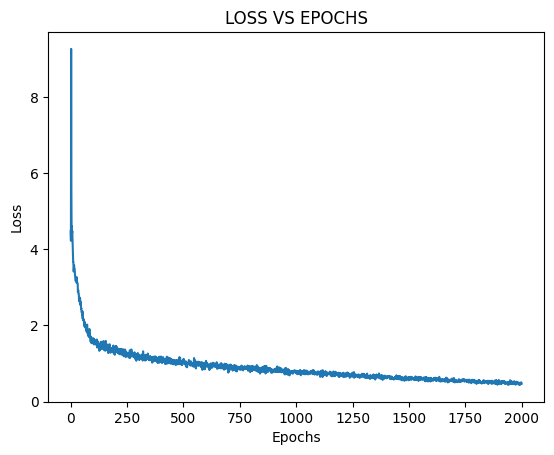

In [16]:
# PLOTTING THE LOSS VS EPOCHS GRAPH

import matplotlib.pyplot as plt

epochs = np.array([i for i in range(num_training_iterations)])

plt.plot(epochs, history)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("LOSS VS EPOCHS")

In [17]:
# RUN THE NOTEBOOK CELLS FROM HERE TO USE THE PRE-TRAINED WEIGHTS

In [18]:
!git clone https://github.com/PrinceShishodia/AI_MelodyMaker.git

Cloning into 'AI_MelodyMaker'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 26 (delta 0), reused 0 (delta 0), pack-reused 23
Receiving objects: 100% (26/26), 91.62 MiB | 4.36 MiB/s, done.


In [19]:
checkpoint_directory = '/content/AI_MelodyMaker/trained_weights'
#weights = os.path.join(checkpoint_directory, "weights")

In [20]:
# PRE-LOADING THE WEIGHTS OF MODEL AND INITIALIZING BATCH SIZE AS 1

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[1, None]),
    tf.keras.layers.LSTM(lstm_units, return_sequences=True, recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid', stateful=True),
    tf.keras.layers.Dense(vocab_size)
  ])

model.load_weights(tf.train.latest_checkpoint(checkpoint_directory))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (1, None, 256)            22528     
                                                                 
 lstm_1 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_1 (Dense)             (1, None, 88)             90200     
                                                                 
Total params: 5359704 (20.45 MB)
Trainable params: 5359704 (20.45 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [21]:
def generate_text(model, start_string, generation_length=1000):

  # CREATING A INPUT SEQUENCE WITH THE PROVIDED STARTING STRING
  input_eval = [char_ind[s] for s in start_string]

  input_eval = tf.expand_dims(input_eval, 0)

  text_generated = []
  model.reset_states()


  for i in range(generation_length):

      # PREDICTING THE OUTPUT SEQUENCE

      predictions = model(input_eval)
      predictions = tf.squeeze(predictions, 0)

      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      input_eval = tf.expand_dims([predicted_id], 0)

      # CONVERTING THE NUMERICAL SEQUENCE BACK TO CHARACTERS IN THE VOCABULARY
      text_generated.append(ind_char[predicted_id])

  # RETURNING THE CHARACTER SEQUENCE
  return (start_string + ''.join(text_generated))

In [23]:
for j in range(10):
  generated_text = generate_text(model, start_string="X", generation_length=500)
  generated_songs = mdl.lab1.extract_song_snippet(generated_text)
  for i, song in enumerate(generated_songs):
    waveform = mdl.lab1.play_song(song)
    ipythondisplay.display(waveform)

Found 2 songs in text


None

Found 2 songs in text


None

Found 0 songs in text
Found 2 songs in text


None

None

Found 0 songs in text
Found 2 songs in text


None

Found 1 songs in text


None

Found 2 songs in text


None

None

Found 1 songs in text


None

Found 1 songs in text
